In [3]:
from ssd_utils.model import SSD300, MultiBoxLoss
from ssd_utils.detect import *

In [4]:
import os
from torch_snippets import *
from PIL import Image
from torch.utils.data import Dataset, DataLoader
import glob
from sklearn.model_selection import train_test_split
import pandas as pd
import torchvision.transforms as transforms
from cluster_utils import coco_annotation_to_df
from torchvision import transforms

In [5]:
from ssd_utils.model import SSD300, MultiBoxLoss
from ssd_utils.detect import *

In [6]:
import os
from torch_snippets import *
from PIL import Image
from torch.utils.data import Dataset, DataLoader
import glob
from sklearn.model_selection import train_test_split
import pandas as pd
import torchvision.transforms as transforms
from cluster_utils import coco_annotation_to_df
from torchvision import transforms

In [7]:
from ssd_utils.model import SSD300, MultiBoxLoss
from ssd_utils.detect import *

In [8]:
from ssd_utils.model import SSD300, MultiBoxLoss
from ssd_utils.detect import *

In [9]:
import os
from torch_snippets import *
from PIL import Image
from torch.utils.data import Dataset, DataLoader
import glob
from sklearn.model_selection import train_test_split
import pandas as pd
import torchvision.transforms as transforms
from cluster_utils import coco_annotation_to_df
from torchvision import transforms

In [10]:
annot_path = "/Users/lin/Documents/python_venvs/cv_with_roboflow_data/Tomato-pest&diseases-1/train/_annotations.coco.json"

annot_df = coco_annotation_to_df(coco_annotation_file=annot_path)

/Users/lin/Documents/python_venvs/pytorch_deepL/lib/python3.9/site-packages/pandas/core/frame.py:4441: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(
/Users/lin/Documents/python_venvs/cv_with_roboflow_data/cluster_utils.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  all_merged_df.dropna(subset=["file_name"], inplace=True)


In [11]:
from ssd_utils.model import SSD300, MultiBoxLoss
from ssd_utils.detect import *

In [12]:
import os
from torch_snippets import *
from PIL import Image
from torch.utils.data import Dataset, DataLoader
import glob
from sklearn.model_selection import train_test_split
import pandas as pd
import torchvision.transforms as transforms
from cluster_utils import coco_annotation_to_df
from torchvision import transforms

In [13]:
annot_path = "/Users/lin/Documents/python_venvs/cv_with_roboflow_data/Tomato-pest&diseases-1/train/_annotations.coco.json"

annot_df = coco_annotation_to_df(coco_annotation_file=annot_path)

/Users/lin/Documents/python_venvs/pytorch_deepL/lib/python3.9/site-packages/pandas/core/frame.py:4441: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(
/Users/lin/Documents/python_venvs/cv_with_roboflow_data/cluster_utils.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  all_merged_df.dropna(subset=["file_name"], inplace=True)


In [14]:
IMAGE_ROOT = '/Users/lin/Documents/python_venvs/cv_with_roboflow_data/Tomato-pest&diseases-1/train/'#'images/images'
#df = '/Users/lin/Documents/python_venvs/modern_cv_with_pytorch/chap8_advanced_obj_detection/open-images-bus-trucks/df.csv'
#DF_RAW = pd.read_csv(df)

sorted_img_list = sorted(glob.glob(f"""{IMAGE_ROOT}*.jpg"""))[:100]

In [15]:
annot_df.file_name
#some_img = sorted_img_list[:100]

0       Characteristic-symptoms-of-Bacterial-canker-di...
1       D-TO-CMIC-FO-004banner_png.rf.16c6d3fa9a6e04ed...
2       bacterial-canker12x2400-1g64sa1_jpg.rf.1aa1b7e...
3       bacterial-canker12x2400-1g64sa1_jpg.rf.1aa1b7e...
4       bacterial-canker12x2400-1g64sa1_jpg.rf.1f8e42f...
                              ...                        
8041    2-26_thumb_png.rf.0f1e11c7623964e83bbfe84f8cdc...
8042    2-26_thumb_png.rf.0f1e11c7623964e83bbfe84f8cdc...
8043    95Bacterial_Spots_jpg.rf.bd21ff2bffde744acc587...
8044    95Bacterial_Spots_jpg.rf.06c4469e9a33772362a7e...
8045    95Bacterial_Spots_jpg.rf.11b50950b2b66b8e4148d...
Name: file_name, Length: 8046, dtype: object

In [16]:
file_names = [img.split('/')[-1] for img in sorted_img_list]

In [17]:
subset_df = annot_df[annot_df['file_name'].isin(file_names)]

In [18]:
img1_path =find(file_names[0], file_names)

In [19]:
img = Image.open(sorted_img_list[0]).convert("RGB")

In [20]:
import matplotlib.pyplot as plt

In [21]:
img_array = plt.imread(sorted_img_list[0])

In [22]:
img1_bbs = subset_df[subset_df['file_name']==file_names[0]]['bbox'].tolist()

In [23]:
img1_labels = subset_df[subset_df['file_name']==file_names[0]]['category_name'].tolist()

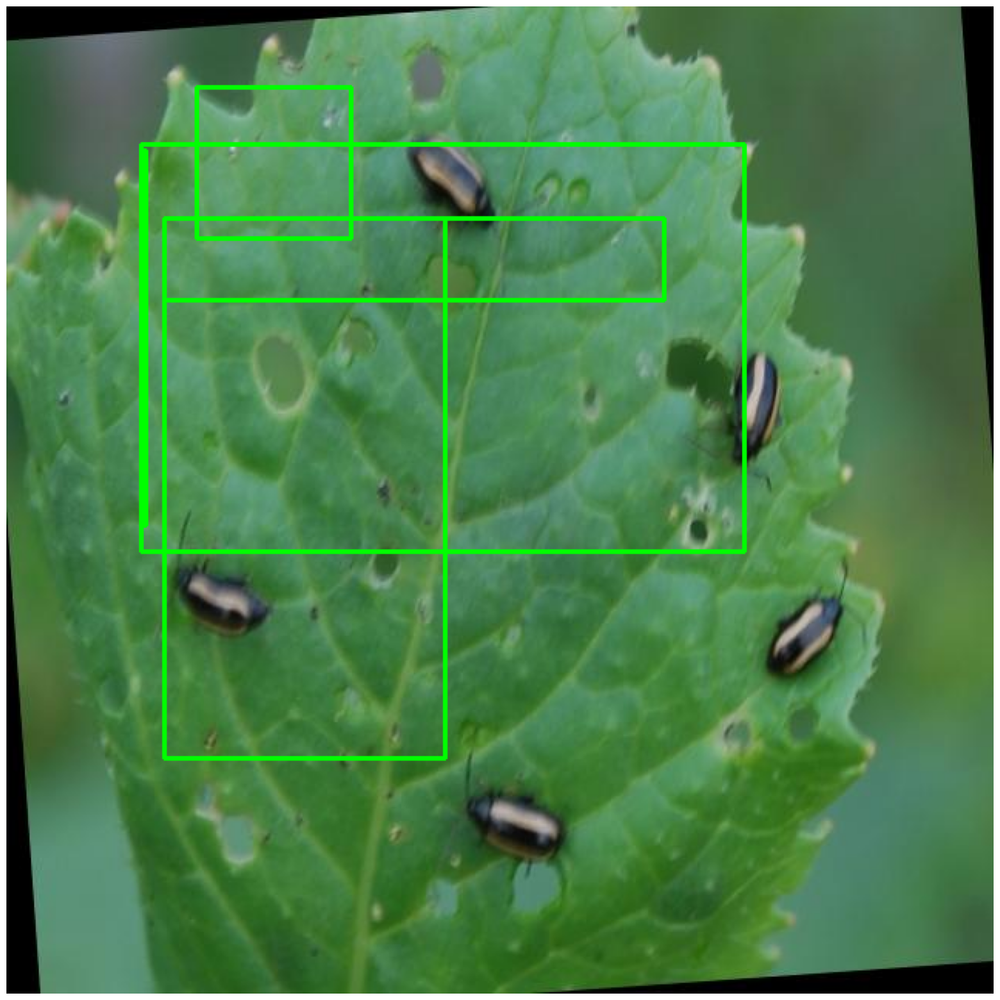

In [24]:
show(img_array, bbs=img1_bbs) 

In [25]:
#img1_bbs[0][2] + img1_bbs[0][0]

In [26]:
img1_bbs_trns = [[imgbbx[0], imgbbx[1], imgbbx[0]+imgbbx[2], imgbbx[1]+imgbbx[3]] 
                 for imgbbx in img1_bbs]

In [27]:
img1_bbs_trns

[[426, 190, 528, 327],
 [478, 353, 565, 442],
 [284, 487, 386, 624],
 [90, 336, 179, 429],
 [223, 52, 346, 202]]

In [28]:
subset_bbx_df = subset_df.copy()

In [29]:
subset_bbx_df[['XMin', 'YMin', 'width', 'height']] =  pd.DataFrame(subset_bbx_df.bbox.tolist(), index= subset_bbx_df.index)

subset_bbx_df['XMax'] = subset_bbx_df['XMin'] + subset_bbx_df['width']

subset_bbx_df['YMax'] = subset_bbx_df['YMin'] + subset_bbx_df['height']

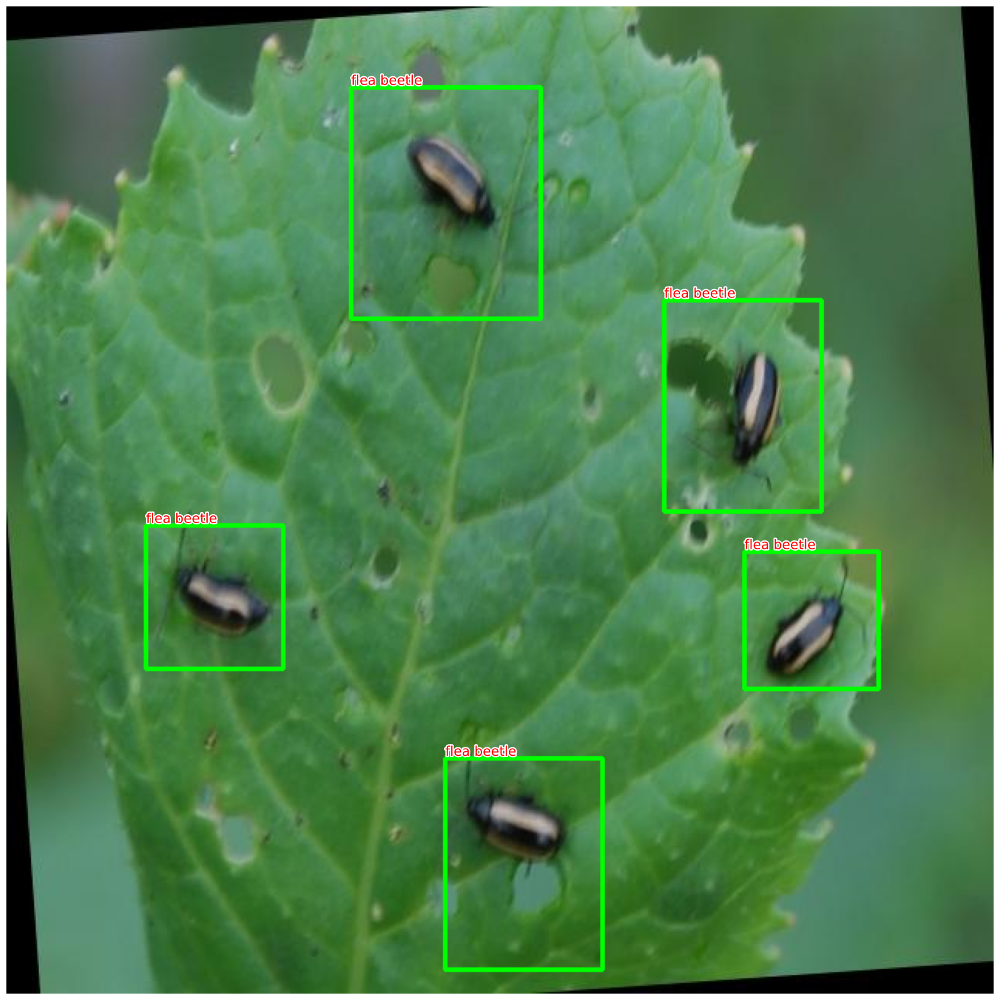

In [30]:
show(img_array, bbs=img1_bbs_trns, texts=img1_labels, text_sz=15)

In [31]:
label2target = {l:t+1 for t,l in enumerate(subset_bbx_df['category_name'].unique())}
label2target['background'] = 0
target2label = {t:l for l,t in label2target.items()}
background_class = label2target['background']
num_classes = len(label2target)

In [32]:
#from torch_snippets import *
#DATA_ROOT = '../open-images-bus-trucks/'
#IMAGE_ROOT = f'{DATA_ROOT}/images'
#DF_RAW = df = pd.read_csv(f'{DATA_ROOT}/df.csv')

#df = df[df['ImageID'].isin(df['ImageID'].unique().tolist())]

#label2target = {l:t+1 for t,l in enumerate(DF_RAW['LabelName'].unique())}
#label2target['background'] = 0
#target2label = {t:l for l,t in label2target.items()}
#background_class = label2target['background']
#num_classes = len(label2target)

device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [33]:
import collections, os, torch
from PIL import Image
from torchvision import transforms
normalize = transforms.Normalize(
    mean=[0.485, 0.456, 0.406],
    std=[0.229, 0.224, 0.225]
)
denormalize = transforms.Normalize(
    mean=[-0.485/0.229, -0.456/0.224, -0.406/0.255],
    std=[1/0.229, 1/0.224, 1/0.255]
)

def preprocess_image(img):
    img = torch.tensor(img).permute(2,0,1)
    img = normalize(img)
    return img.to(device).float()
    
class OpenDataset(torch.utils.data.Dataset):
    w, h = 300, 300
    def __init__(self, df, image_dir=IMAGE_ROOT):
        self.image_dir = image_dir
        self.files = glob.glob(self.image_dir+'/*')
        self.df = df
        #self.image_infos = df.ImageID.unique()
        self.image_infos = df.file_name.unique()
        logger.info(f'{len(self)} items loaded')
        
    def __getitem__(self, ix):
        # load images and masks
        image_id = self.image_infos[ix]
        img_path = find(image_id, self.files)
        img = Image.open(img_path).convert("RGB")
        img = np.array(img.resize((self.w, self.h), resample=Image.BILINEAR))/255.
        #data = df[df['ImageID'] == image_id]
        #labels = data['LabelName'].values.tolist()
        data = self.df[self.df['file_name'] == image_id]
        labels = data['category_name'].values.tolist()
        data = data[['XMin','YMin','XMax','YMax']].values
        data[:,[0,2]] *= self.w
        data[:,[1,3]] *= self.h
        boxes = data.astype(np.uint32).tolist() # convert to absolute coordinates
        return img, boxes, labels

    def collate_fn(self, batch):
        images, boxes, labels = [], [], []
        for item in batch:
            img, image_boxes, image_labels = item
            img = preprocess_image(img)[None]
            images.append(img)
            boxes.append(torch.tensor(image_boxes).float().to(device)/300.)
            labels.append(torch.tensor([label2target[c] for c in image_labels]).long().to(device))
        images = torch.cat(images).to(device)
        return images, boxes, labels
    def __len__(self):
        return len(self.image_infos)

In [34]:
from sklearn.model_selection import train_test_split
trn_ids, val_ids = train_test_split(subset_bbx_df.file_name.unique(), test_size=0.1, random_state=99)
trn_df, val_df = subset_bbx_df[subset_bbx_df['file_name'].isin(trn_ids)], subset_bbx_df[subset_bbx_df['file_name'].isin(val_ids)]
len(trn_df), len(val_df)

train_ds = OpenDataset(trn_df)
test_ds = OpenDataset(val_df)

train_loader = DataLoader(train_ds, batch_size=4, collate_fn=train_ds.collate_fn, drop_last=True)
test_loader = DataLoader(test_ds, batch_size=4, collate_fn=test_ds.collate_fn, drop_last=True)

[11/12/23 17:24:19] INFO     90 items loaded             ]8;id=51621;file://<ipython-input-33-0275ec72c91c>\<ipython-input-33-0275ec72c91c>]8;;\:]8;id=550112;file://<ipython-input-33-0275ec72c91c>#__init__:27\__init__:27]8;;\

                    INFO     10 items loaded             ]8;id=283230;file://<ipython-input-33-0275ec72c91c>\<ipython-input-33-0275ec72c91c>]8;;\:]8;id=91958;file://<ipython-input-33-0275ec72c91c>#__init__:27\__init__:27]8;;\

In [35]:
def train_batch(inputs, model, criterion, optimizer):
    model.train()
    N = len(train_loader)
    images, boxes, labels = inputs
    _regr, _clss = model(images)
    loss = criterion(_regr, _clss, boxes, labels)
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    return loss
    
@torch.no_grad()
def validate_batch(inputs, model, criterion):
    model.eval()
    images, boxes, labels = inputs
    _regr, _clss = model(images)
    loss = criterion(_regr, _clss, boxes, labels)
    return loss

In [36]:
#from model import SSD300, MultiBoxLoss
#from detect import *

In [37]:
n_epochs = 3

model = SSD300(num_classes, device)
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4, weight_decay=1e-5)
criterion = MultiBoxLoss(priors_cxcy=model.priors_cxcy, device=device)

log = Report(n_epochs=n_epochs)
logs_to_print = 5

/Users/lin/Documents/python_venvs/pytorch_deepL/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/Users/lin/Documents/python_venvs/pytorch_deepL/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)



Loaded base model.



/Users/lin/Documents/python_venvs/pytorch_deepL/lib/python3.9/site-packages/torch/nn/_reduction.py:42: UserWarning: size_average and reduce args will be deprecated, please use reduction='none' instead.
  warnings.warn(warning.format(ret))


In [38]:
model

SSD300(
  (base): VGGBase(
    (conv1_1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv1_2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (conv2_1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv2_2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (conv3_1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv3_2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv3_3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=True)
    (conv4_1): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv4_2): Conv2d(512, 512, kernel_size=(3, 3), 

In [39]:
for epoch in range(n_epochs):
    _n = len(train_loader)
    for ix, inputs in enumerate(train_loader):
        loss = train_batch(inputs, model, criterion, optimizer)
        pos = (epoch + (ix+1)/_n)
        log.record(pos, trn_loss=loss.item(), end='\r')

    _n = len(test_loader)
    for ix,inputs in enumerate(test_loader):
        loss = validate_batch(inputs, model, criterion)
        pos = (epoch + (ix+1)/_n)
        log.record(pos, val_loss=loss.item(), end='\r')

<ipython-input-33-0275ec72c91c>:34: DeprecationWarning: BILINEAR is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.BILINEAR instead.
  img = np.array(img.resize((self.w, self.h), resample=Image.BILINEAR))/255.


EPOCH: 3.000  val_loss: 18321.119  (1102.36s - 0.00s remaining)g)

In [40]:
#image_paths = Glob(f'{DATA_ROOT}/images/*')
image_paths = Glob(f'{IMAGE_ROOT}/*')
image_id = choose(test_ds.image_infos)
img_path = find(image_id, test_ds.files)
original_image = Image.open(img_path, mode='r')
original_image = original_image.convert('RGB')

[[0, 0, 640, 640]]
['background @ 0.00']

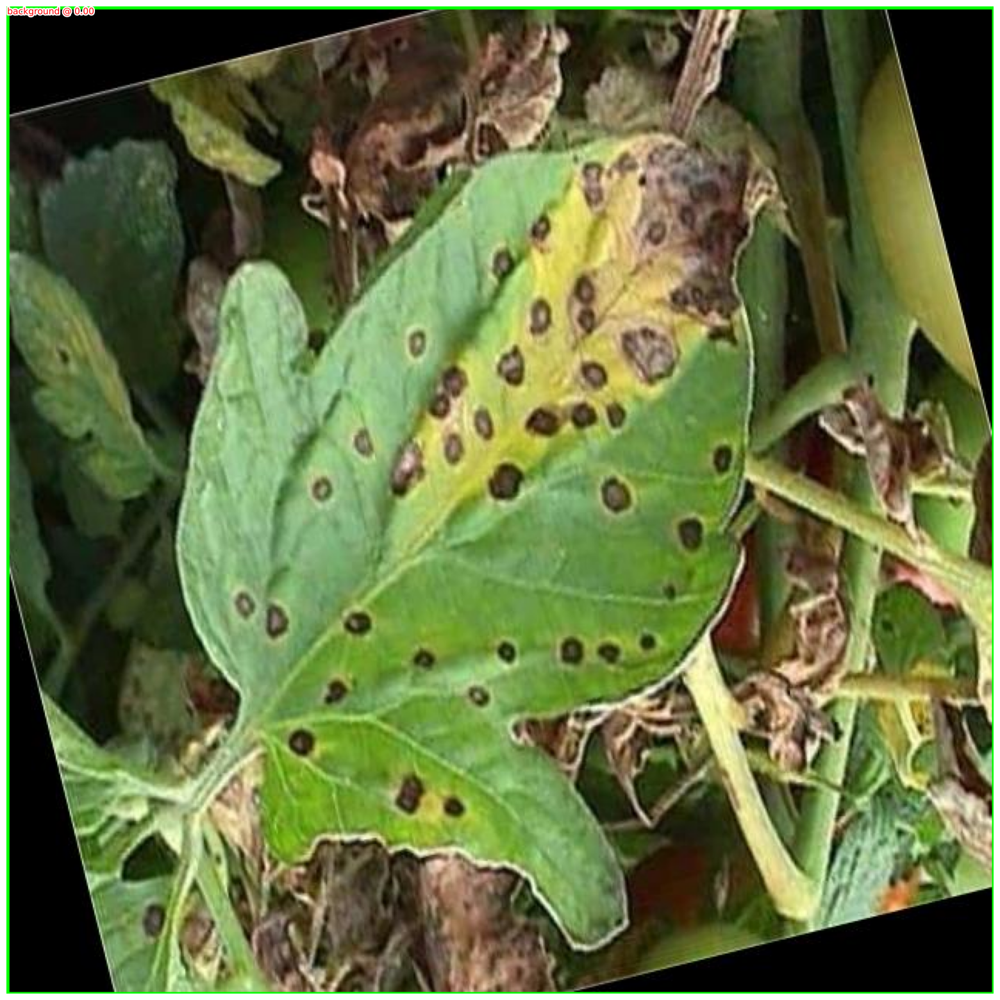

[[0, 0, 640, 640]]
['background @ 0.00']

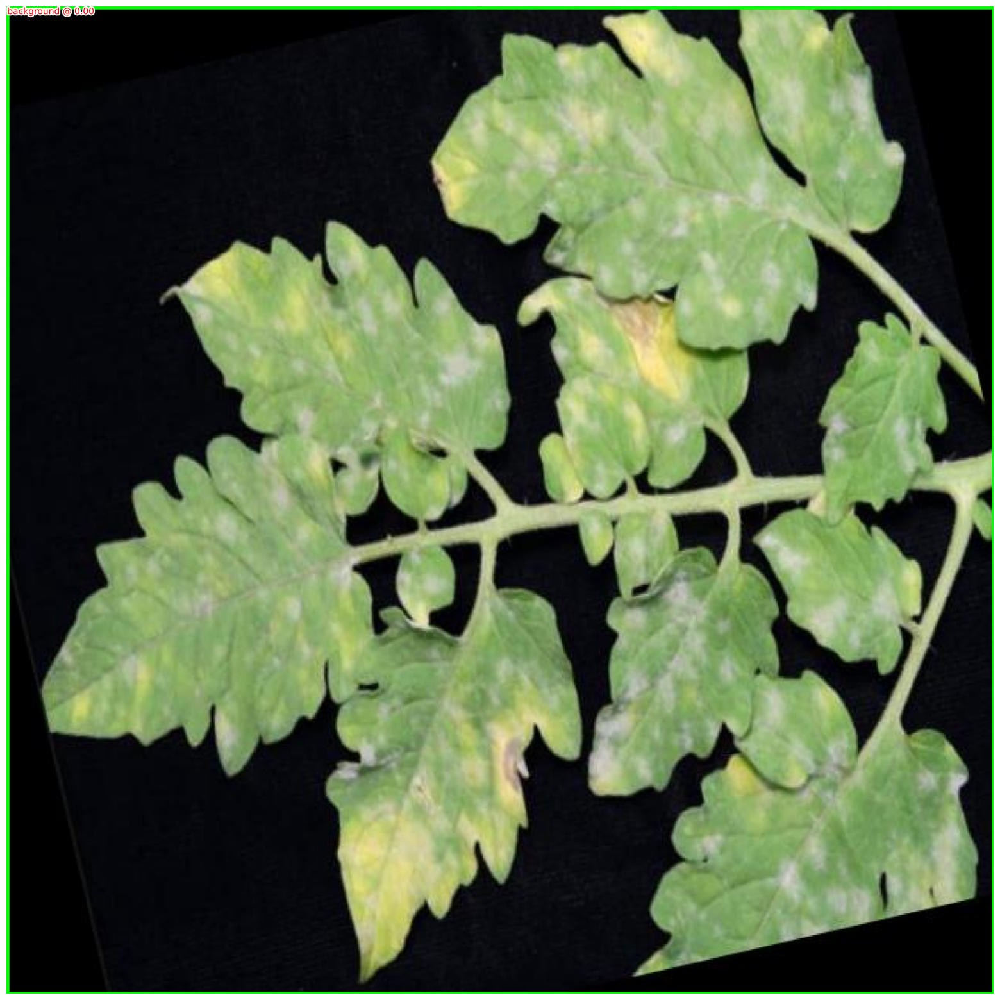

[[0, 0, 640, 640]]
['background @ 0.00']

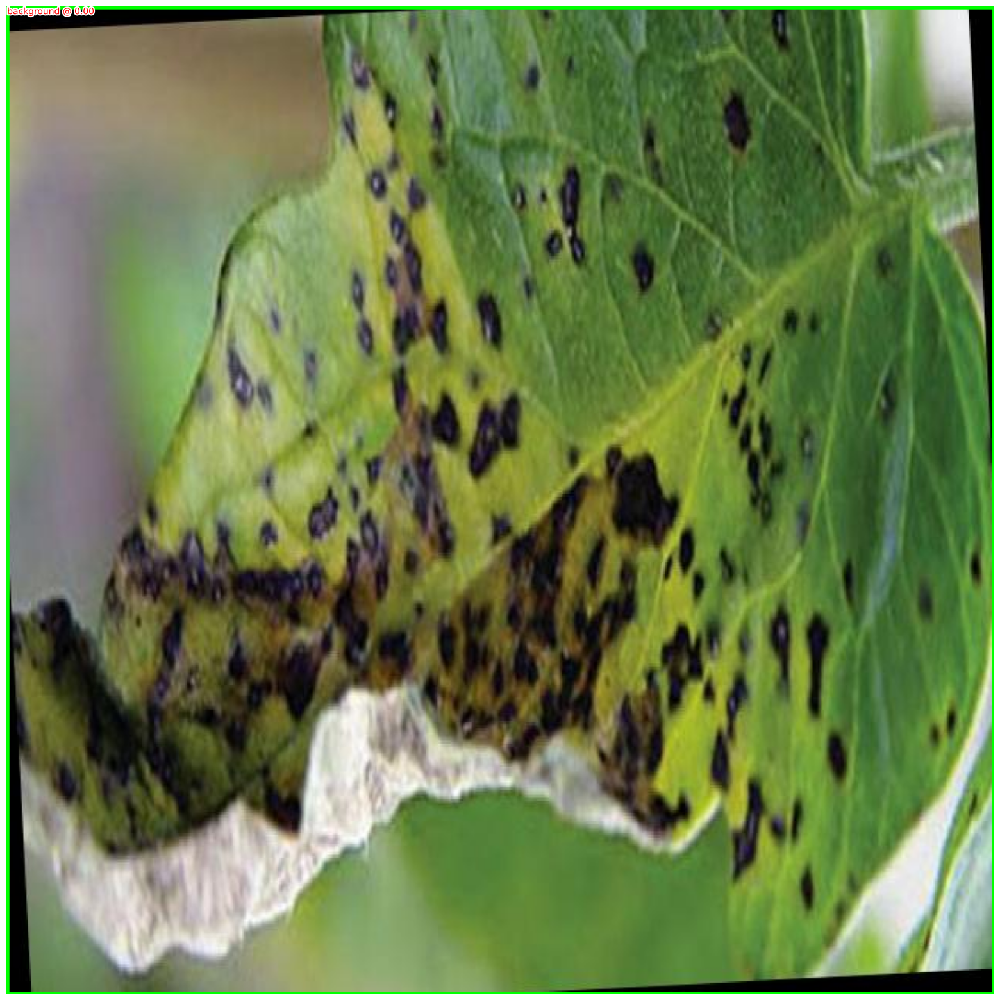

In [41]:
#image_paths = Glob(f'{DATA_ROOT}/images/*')

image_paths = Glob(f'{IMAGE_ROOT}/*')
for _ in range(3):
    image_id = choose(test_ds.image_infos)
    img_path = find(image_id, test_ds.files)
    original_image = Image.open(img_path, mode='r')
    bbs, labels, scores = detect(original_image, model, min_score=0.9, max_overlap=0.5,top_k=200, device=device)
    labels = [target2label[c.item()] for c in labels]
    label_with_conf = [f'{l} @ {s:.2f}' for l,s in zip(labels,scores)]
    print(bbs, label_with_conf)
    show(original_image, bbs=bbs, texts=label_with_conf, text_sz=10)

[[0, 0, 640, 640]]
['background @ 0.00']

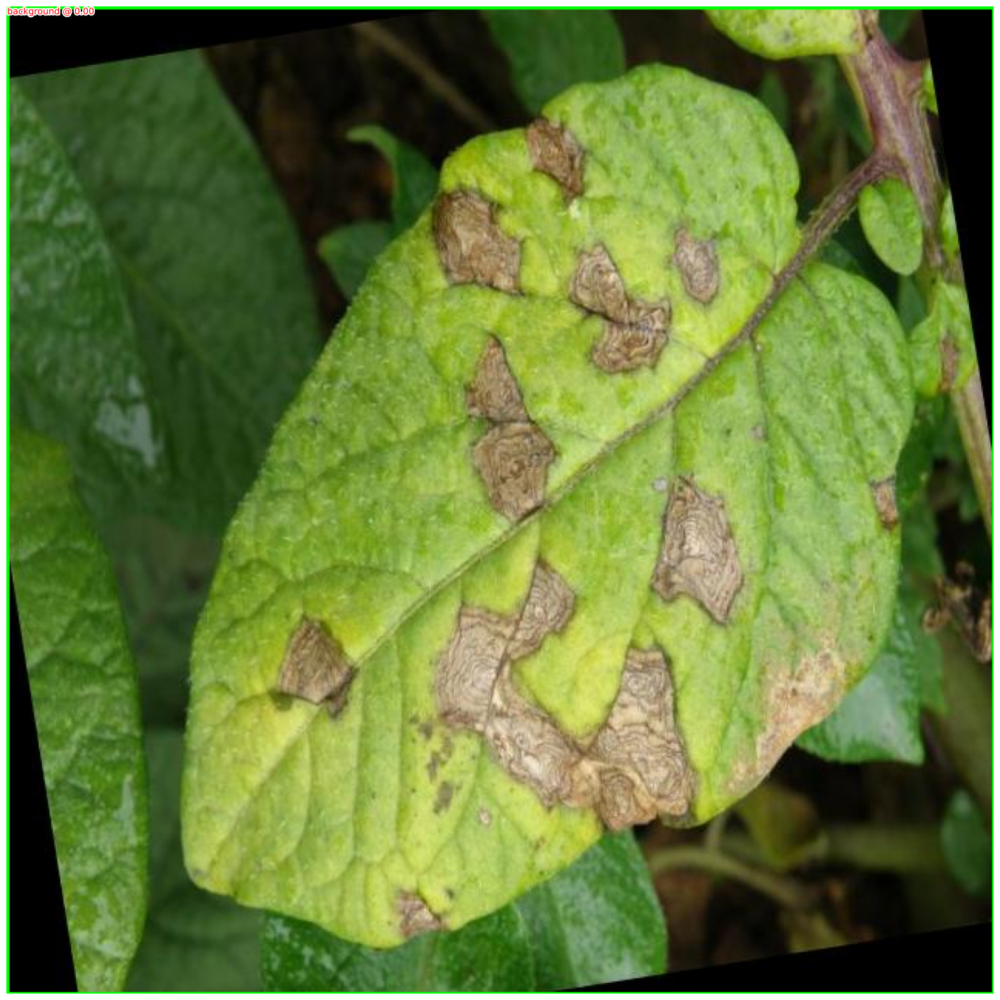

[[0, 0, 640, 640]]
['background @ 0.00']

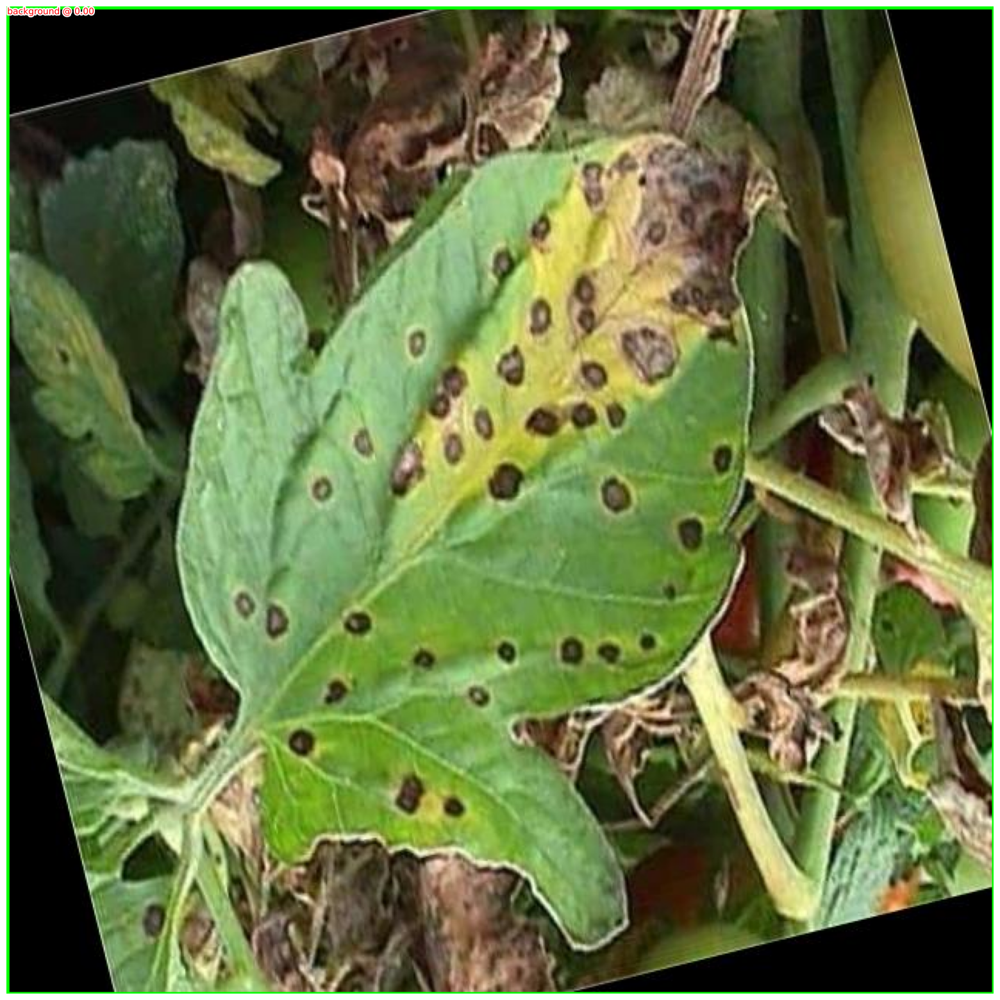

[[0, 0, 640, 640]]
['background @ 0.00']

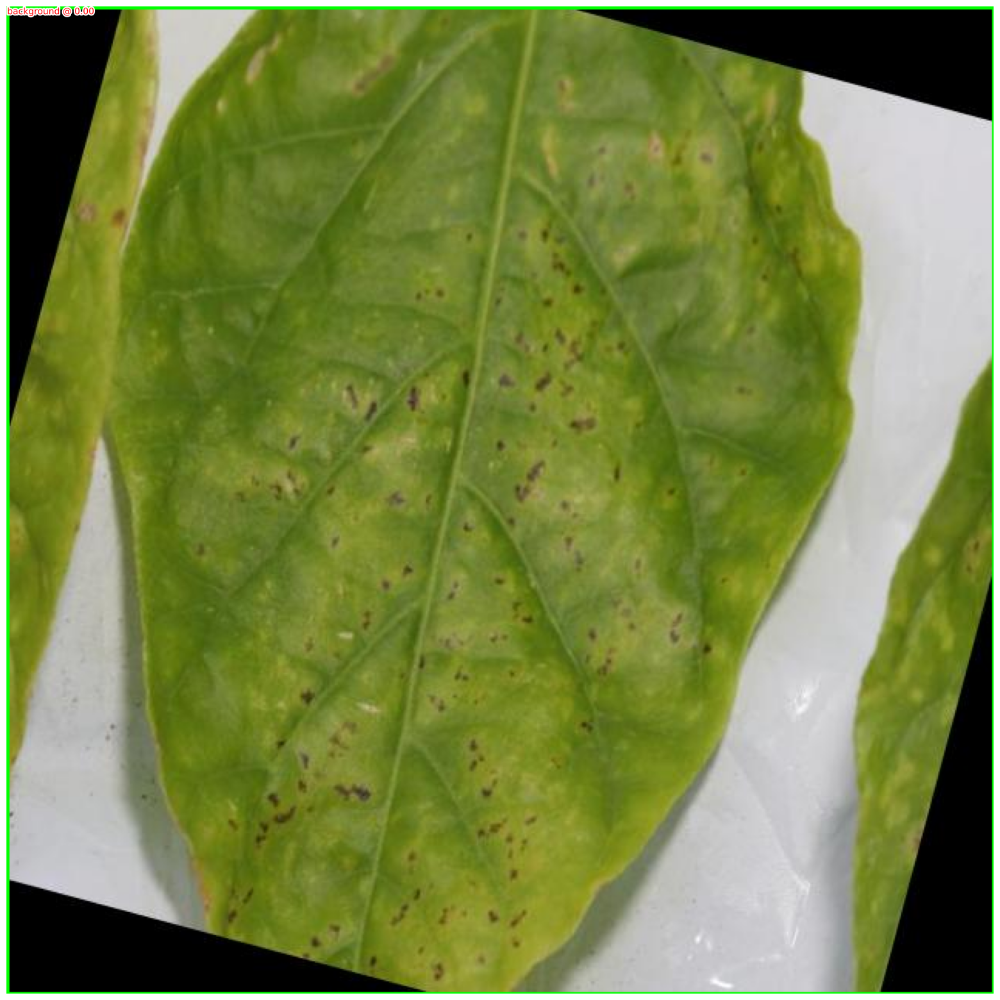

[[0, 0, 640, 640]]
['background @ 0.00']

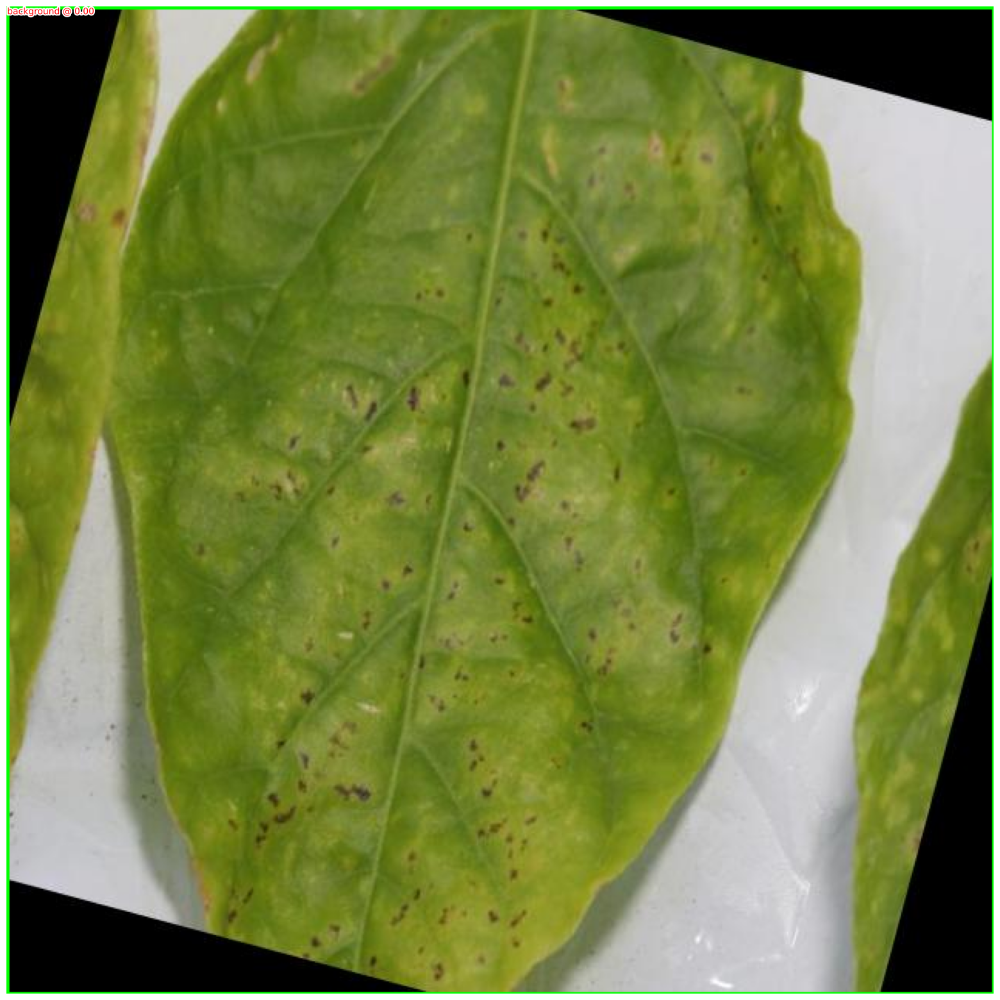

[[0, 0, 640, 640]]
['background @ 0.00']

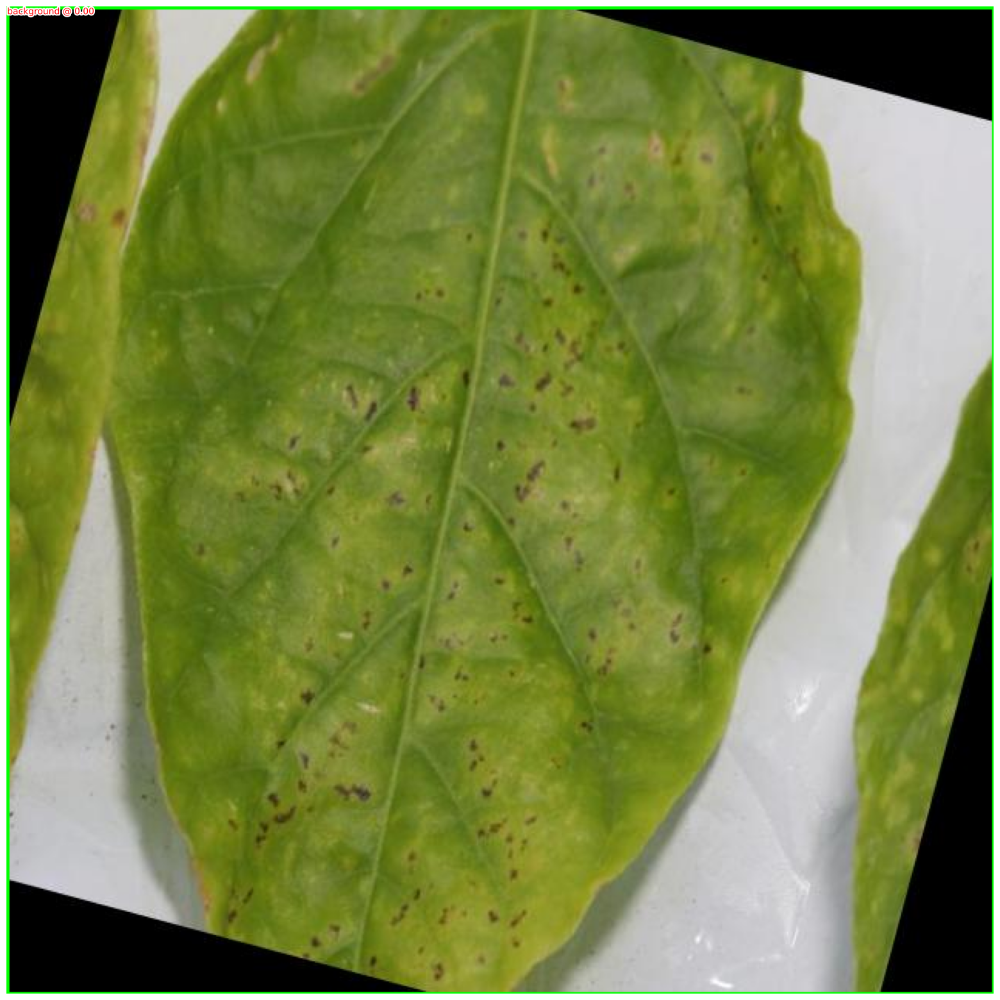

[[0, 0, 640, 640]]
['background @ 0.00']

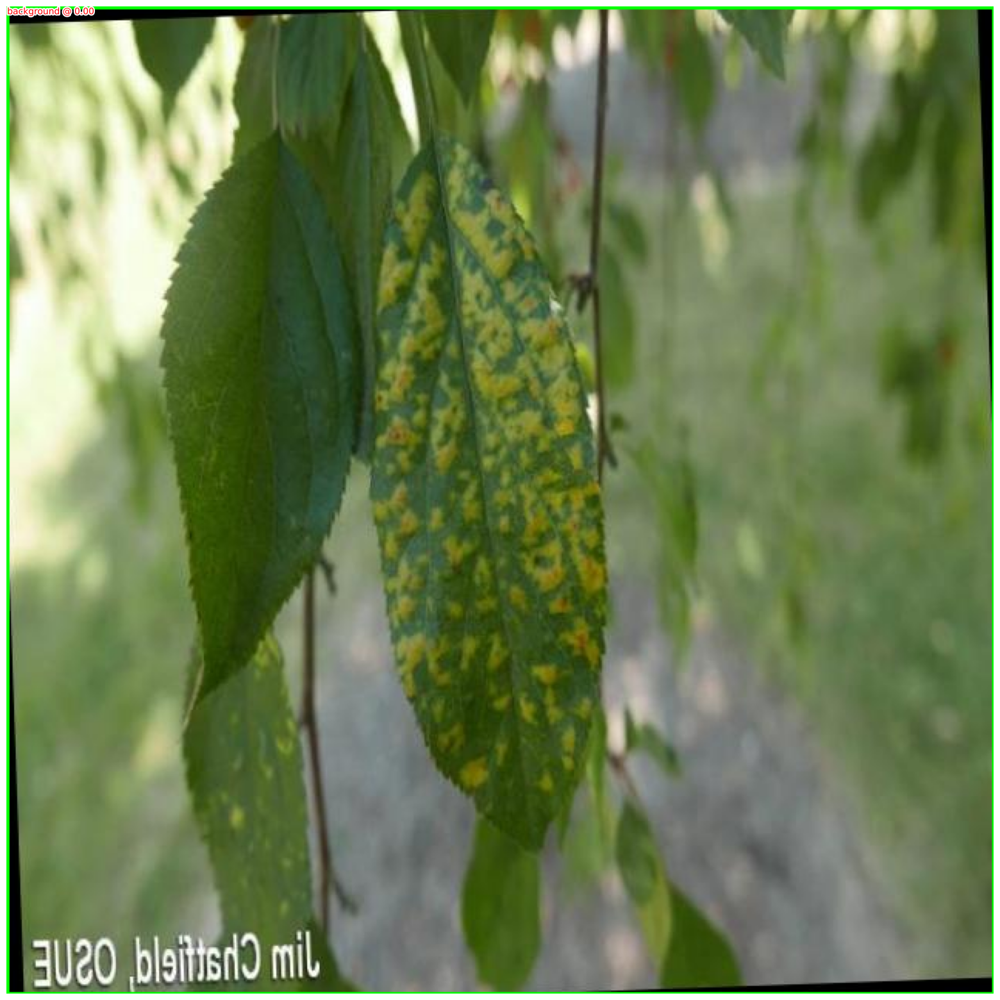

[[0, 0, 640, 640]]
['background @ 0.00']

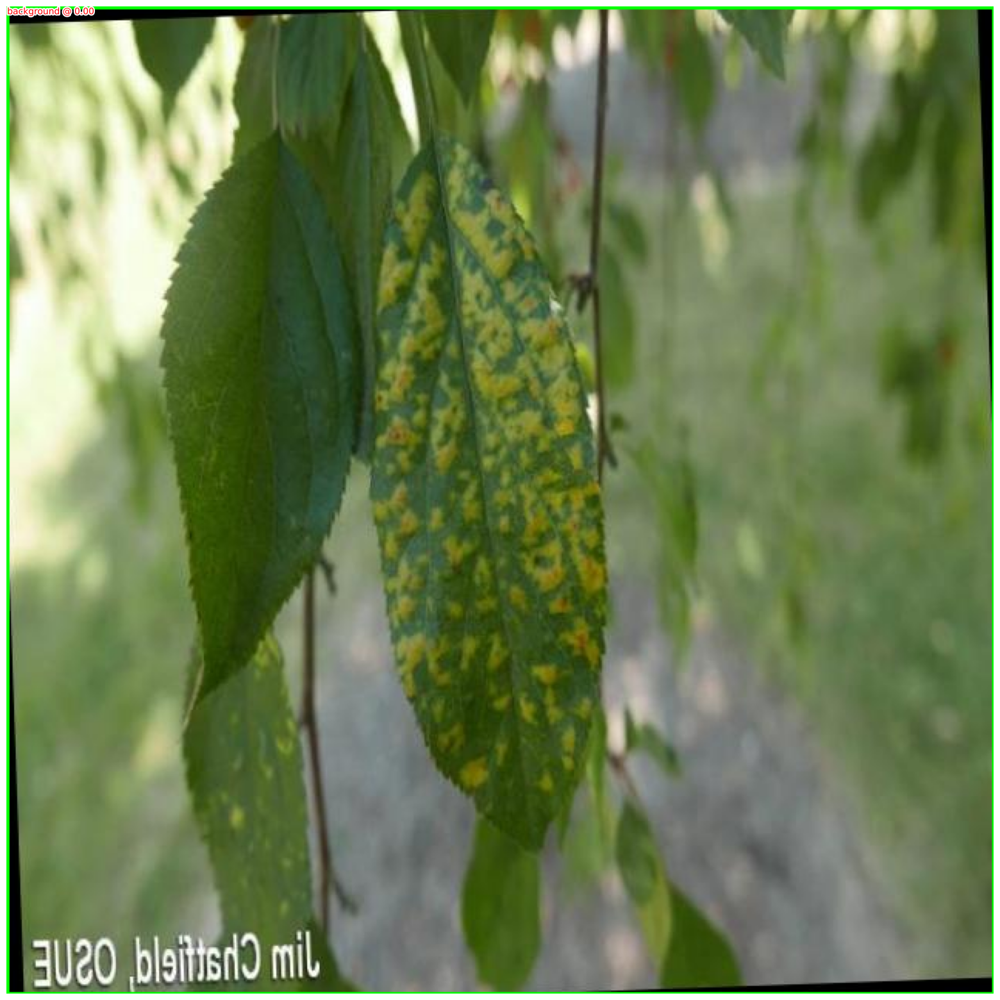

[[0, 0, 640, 640]]
['background @ 0.00']

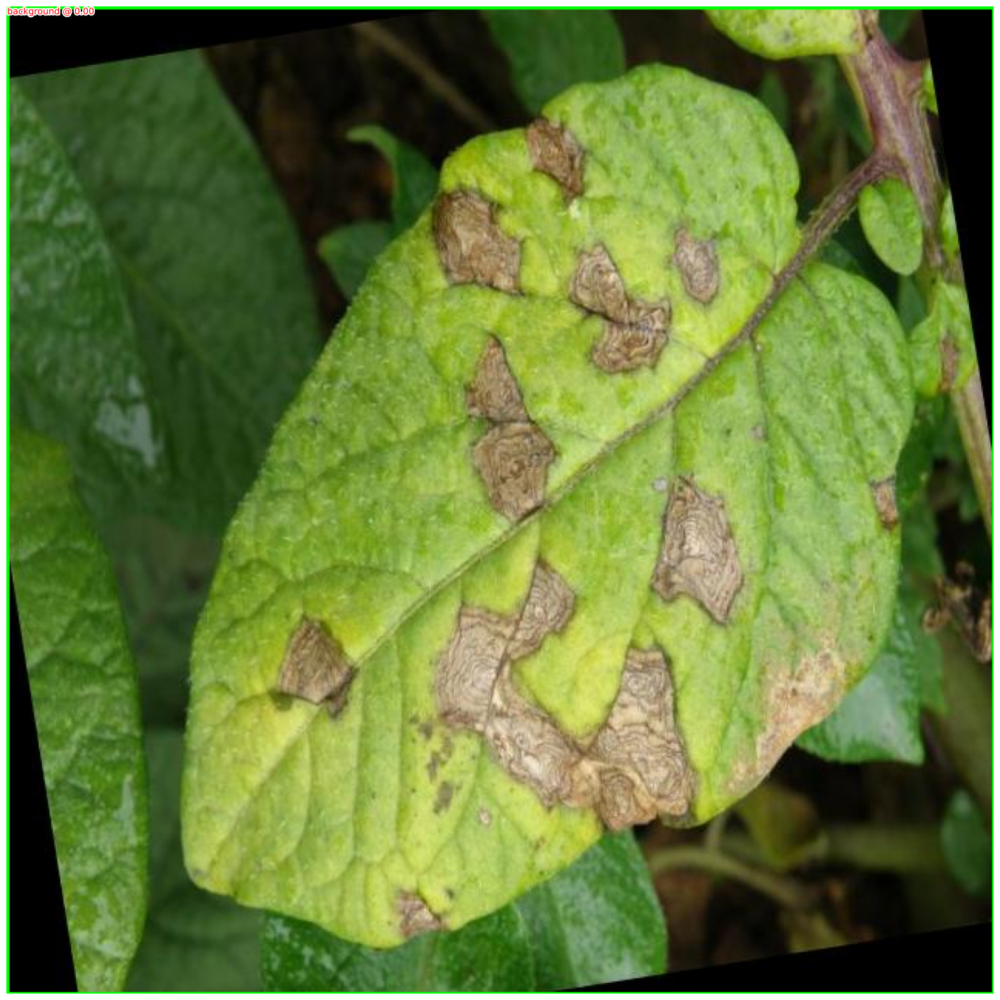

[[0, 0, 640, 640]]
['background @ 0.00']

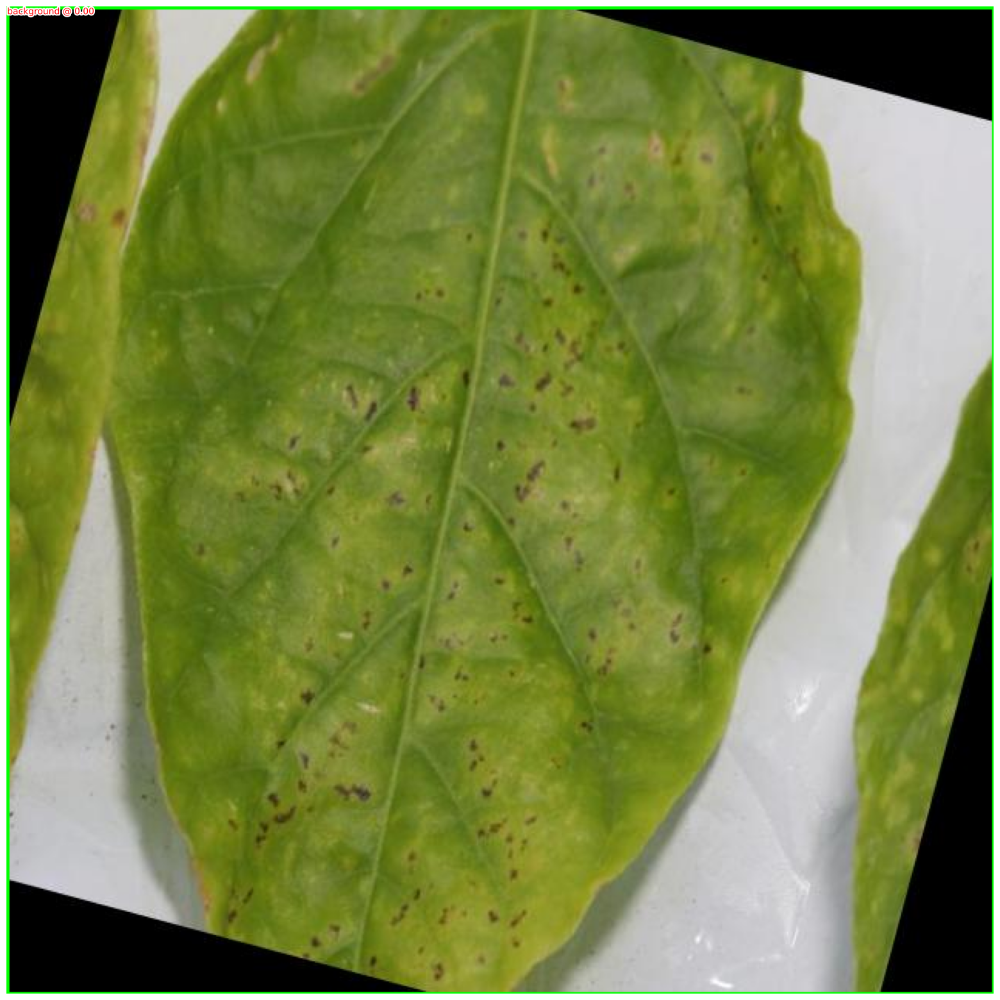

[[0, 0, 640, 640]]
['background @ 0.00']

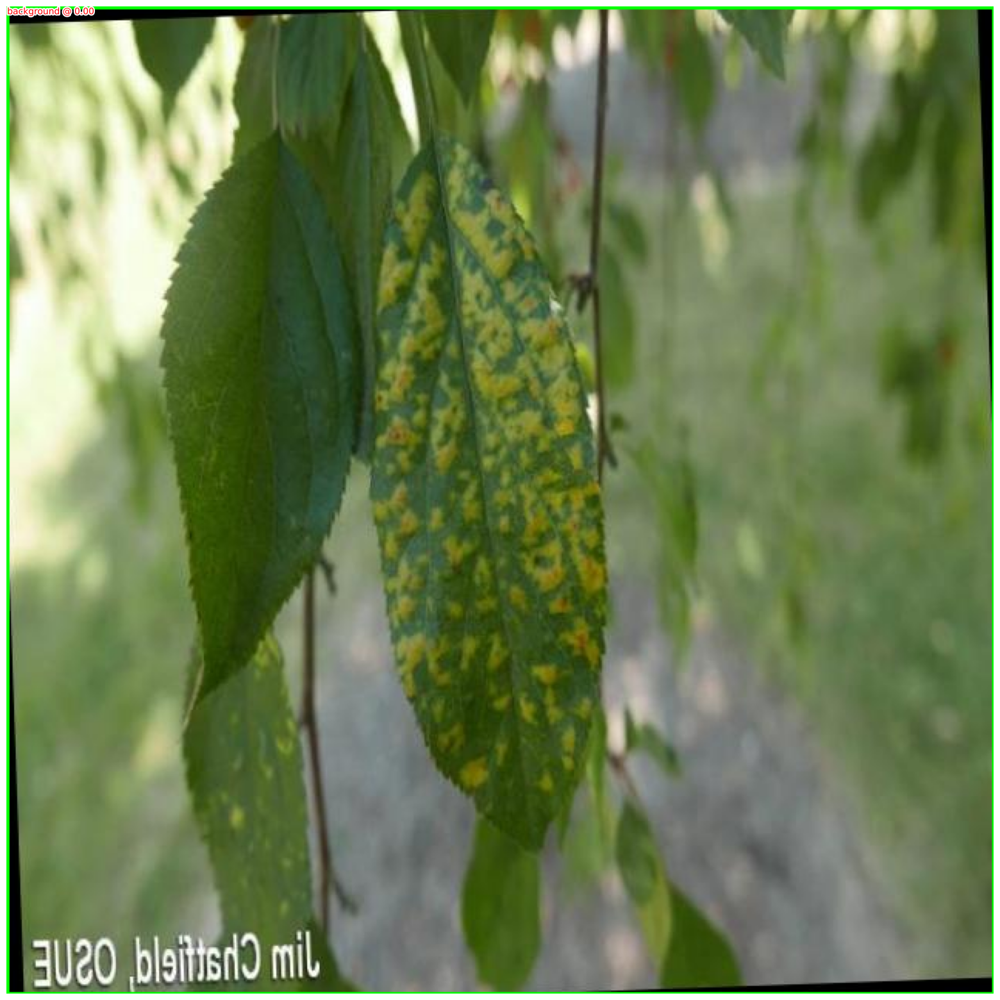

[[0, 0, 640, 640]]
['background @ 0.00']

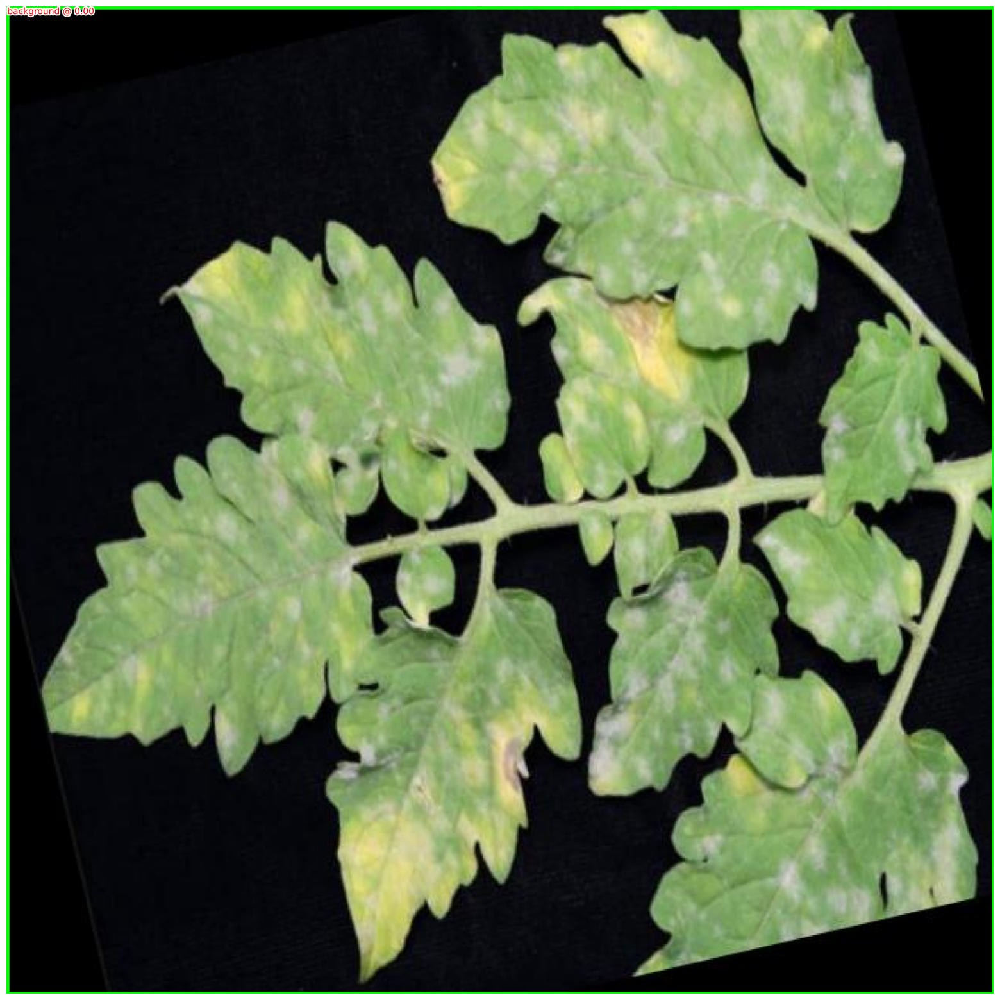

[[0, 0, 640, 640]]
['background @ 0.00']

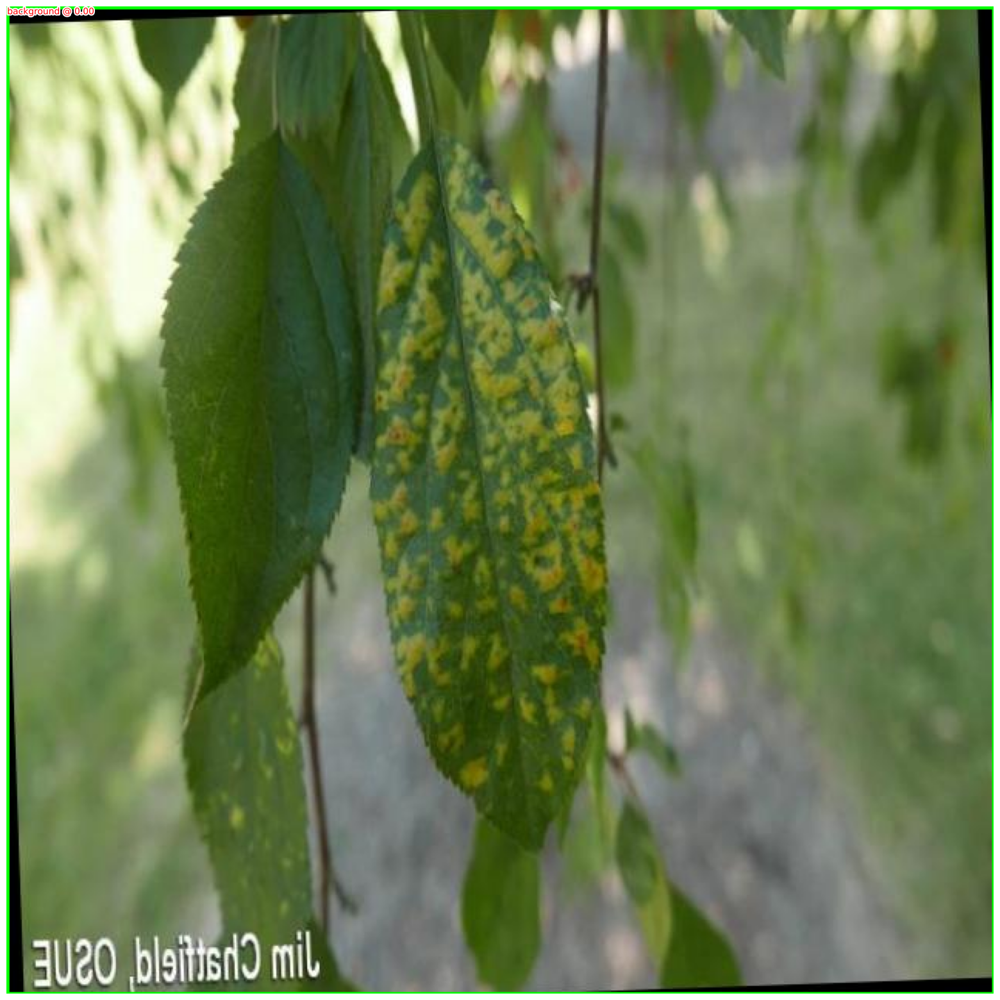

[[0, 0, 640, 640]]
['background @ 0.00']

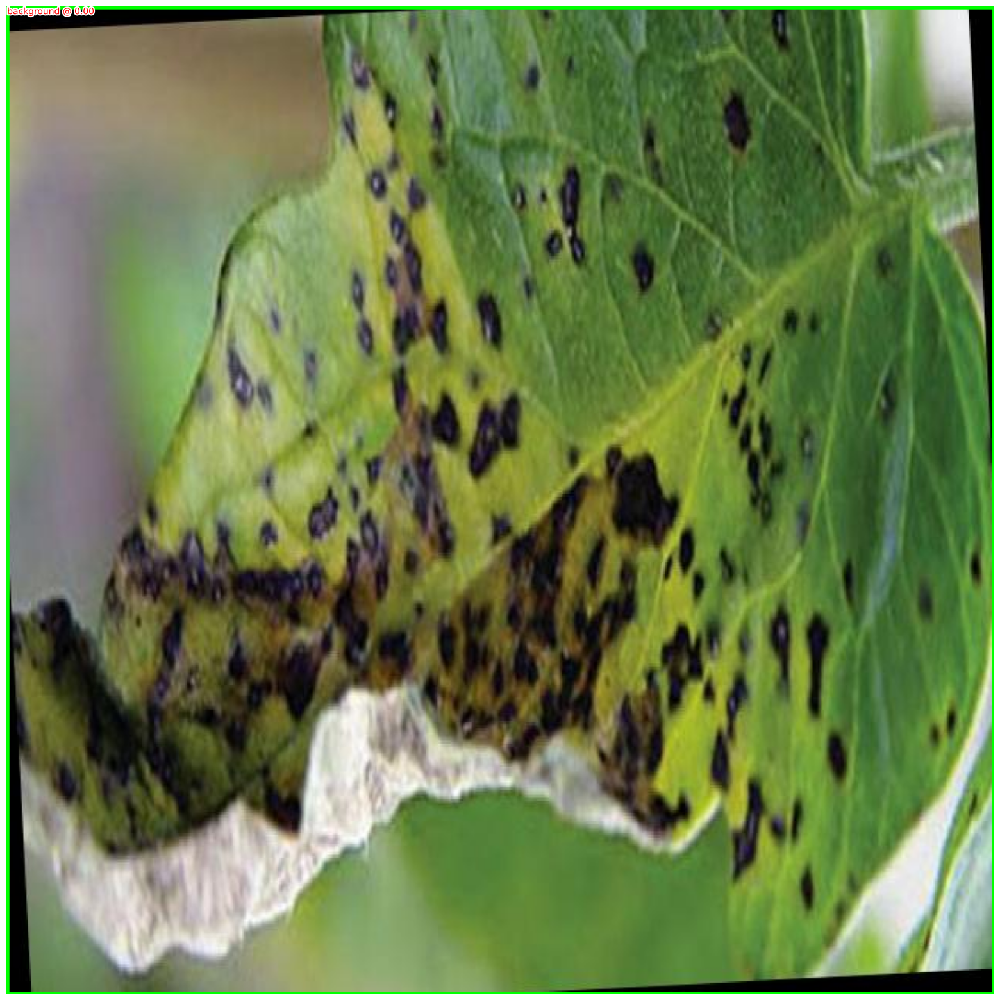

In [42]:
#image_paths = Glob(f'{DATA_ROOT}/images/*')

image_paths = Glob(f'{IMAGE_ROOT}/*')
for _ in range(13):
    image_id = choose(test_ds.image_infos)
    img_path = find(image_id, test_ds.files)
    original_image = Image.open(img_path, mode='r')
    bbs, labels, scores = detect(original_image, model, min_score=0.9, max_overlap=0.5,top_k=200, device=device)
    labels = [target2label[c.item()] for c in labels]
    label_with_conf = [f'{l} @ {s:.2f}' for l,s in zip(labels,scores)]
    print(bbs, label_with_conf)
    show(original_image, bbs=bbs, texts=label_with_conf, text_sz=10)